## Insurance fraud detection is a challenging problem, given the variety of fraud patterns and relatively small ratio of known frauds in typical samples. While building detection models, the savings from loss prevention needs to be balanced with cost of false alerts. 

**Insurance frauds cover the range of improper activities which an individual may commit in order to achieve a favorable outcome from the insurance company. This could range from staging the incident, misrepresenting the situation including the relevant actors and the cause of incident and finally the extent of damage caused**.

### Potential situations could include:

- Covering-up for a situation that wasn’t covered under insurance (e.g. drunk driving, performing risky acts, illegal activities etc.)
- Misrepresenting the context of the incident: This could include transferring the blame to incidents where the insured party is to blame, failure to take agreed upon safety measures
- Infiating the impact of the incident: Increasing the estimate of loss incurred either through addition of unrelated losses (faking losses) or attributing increased cost to the losses
- The insurance industry has grappled with the challenge of insurance claim fraud from the very start. On one hand, there is the challenge of impact to customer satisfaction through delayed payouts or prolonged investigation during a period of stress. Additionally, there are costs of investigation and pressure from insurance industry regulators. On the other hand, improper payouts cause a hit to profitability and encourage similar delinquent behavior from other policy holders.

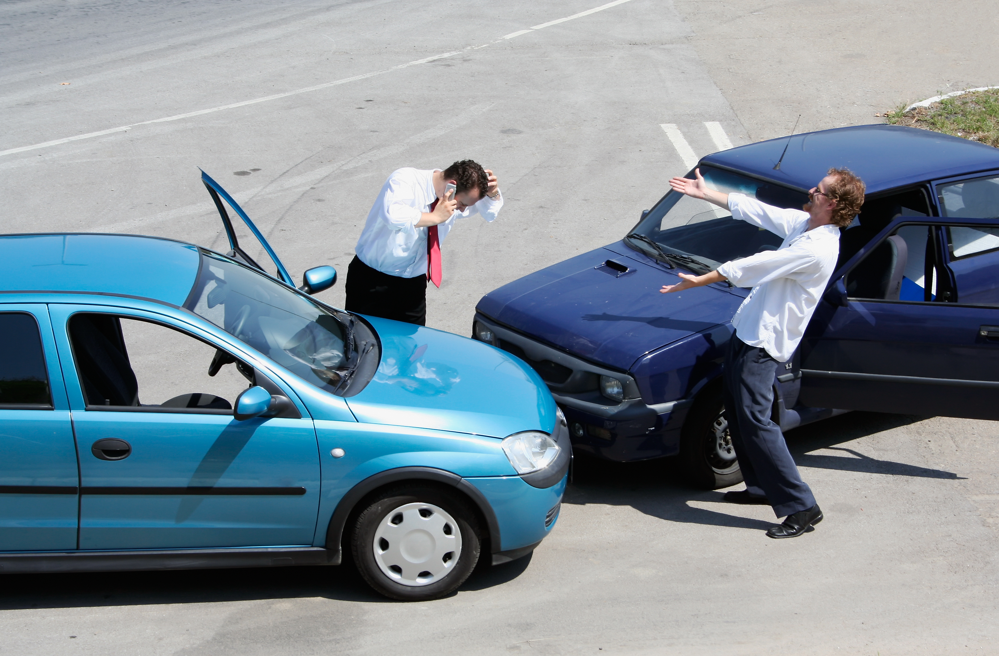

## Analysis Content 
* 1.[Import Packages](#1)
* 2.[Data Read](#2)
* 3.[EDA](#3)
* 4.[Data Preprocessing](#4)
* 5.[Machine learning Modelling](#5) 
* 6.[Conclusion](#6)

<a id="1"></a>
## Import Packages

In [958]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import seaborn as sns
import matplotlib.pyplot as plt

<a id="2"></a>
## Data Read

In [959]:
df=pd.read_csv("file:///C:/Users/angsh/OneDrive/Desktop/PRAXIS/Own%20Projects/ML/insurance_claims.csv")

In [960]:
df.head(2)

,months_as_customer,age,policy_number,policy_bind_date,policy_state,policy_csl,policy_deductable,policy_annual_premium,umbrella_limit,insured_zip,...,police_report_available,total_claim_amount,injury_claim,property_claim,vehicle_claim,auto_make,auto_model,auto_year,fraud_reported,_c39
0,328,48,521585,2014-10-17,OH,250/500,1000,1406.91,0,466132,...,YES,71610,6510,13020,52080,Saab,92x,2004,Y,NaN
1,228,42,342868,2006-06-27,IN,250/500,2000,1197.22,5000000,468176,...,?,5070,780,780,3510,Mercedes,E400,2007,Y,NaN


In [961]:
df.tail(2)

,months_as_customer,age,policy_number,policy_bind_date,policy_state,policy_csl,policy_deductable,policy_annual_premium,umbrella_limit,insured_zip,...,police_report_available,total_claim_amount,injury_claim,property_claim,vehicle_claim,auto_make,auto_model,auto_year,fraud_reported,_c39
998,458,62,533940,2011-11-18,IL,500/1000,2000,1356.92,5000000,441714,...,YES,46980,5220,5220,36540,Audi,A5,1998,N,NaN
999,456,60,556080,1996-11-11,OH,250/500,1000,766.19,0,612260,...,?,5060,460,920,3680,Mercedes,E400,2007,N,NaN


<a id="3"></a>
## EDA

In [962]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 40 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   months_as_customer           1000 non-null   int64  
 1   age                          1000 non-null   int64  
 2   policy_number                1000 non-null   int64  
 3   policy_bind_date             1000 non-null   object 
 4   policy_state                 1000 non-null   object 
 5   policy_csl                   1000 non-null   object 
 6   policy_deductable            1000 non-null   int64  
 7   policy_annual_premium        1000 non-null   float64
 8   umbrella_limit               1000 non-null   int64  
 9   insured_zip                  1000 non-null   int64  
 10  insured_sex                  1000 non-null   object 
 11  insured_education_level      1000 non-null   object 
 12  insured_occupation           1000 non-null   object 
 13  insured_hobbies    

In [963]:
df.shape

(1000, 40)

# Check for Missing Values

In [964]:
df.isnull().sum()

months_as_customer                0
age                               0
policy_number                     0
policy_bind_date                  0
policy_state                      0
policy_csl                        0
policy_deductable                 0
policy_annual_premium             0
umbrella_limit                    0
insured_zip                       0
insured_sex                       0
insured_education_level           0
insured_occupation                0
insured_hobbies                   0
insured_relationship              0
capital-gains                     0
capital-loss                      0
incident_date                     0
incident_type                     0
collision_type                    0
incident_severity                 0
authorities_contacted             0
incident_state                    0
incident_city                     0
incident_location                 0
incident_hour_of_the_day          0
number_of_vehicles_involved       0
property_damage             

In [965]:
df.duplicated().sum()

0

In [966]:
df.drop('_c39',axis=1,inplace=True)

In [967]:
# Deleteing the c_39 column as all the values in the feature set is NAN.
df.head(2)

,months_as_customer,age,policy_number,policy_bind_date,policy_state,policy_csl,policy_deductable,policy_annual_premium,umbrella_limit,insured_zip,...,witnesses,police_report_available,total_claim_amount,injury_claim,property_claim,vehicle_claim,auto_make,auto_model,auto_year,fraud_reported
0,328,48,521585,2014-10-17,OH,250/500,1000,1406.91,0,466132,...,2,YES,71610,6510,13020,52080,Saab,92x,2004,Y
1,228,42,342868,2006-06-27,IN,250/500,2000,1197.22,5000000,468176,...,0,?,5070,780,780,3510,Mercedes,E400,2007,Y


In [968]:
df.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
months_as_customer,1000.0,2.039540e+02,1.151132e+02,0.00,115.7500,199.5,276.250,479.00
age,1000.0,3.894800e+01,9.140287e+00,19.00,32.0000,38.0,44.000,64.00
policy_number,1000.0,5.462386e+05,2.570630e+05,100804.00,335980.2500,533135.0,759099.750,999435.00
policy_deductable,1000.0,1.136000e+03,6.118647e+02,500.00,500.0000,1000.0,2000.000,2000.00
policy_annual_premium,1000.0,1.256406e+03,2.441674e+02,433.33,1089.6075,1257.2,1415.695,2047.59
umbrella_limit,1000.0,1.101000e+06,2.297407e+06,-1000000.00,0.0000,0.0,0.000,10000000.00
insured_zip,1000.0,5.012145e+05,7.170161e+04,430104.00,448404.5000,466445.5,603251.000,620962.00
capital-gains,1000.0,2.512610e+04,2.787219e+04,0.00,0.0000,0.0,51025.000,100500.00
capital-loss,1000.0,-2.679370e+04,2.810410e+04,-111100.00,-51500.0000,-23250.0,0.000,0.00
incident_hour_of_the_day,1000.0,1.164400e+01,6.951373e+00,0.00,6.0000,12.0,17.000,23.00


In [969]:
df.columns

Index(['months_as_customer', 'age', 'policy_number', 'policy_bind_date',
       'policy_state', 'policy_csl', 'policy_deductable',
       'policy_annual_premium', 'umbrella_limit', 'insured_zip', 'insured_sex',
       'insured_education_level', 'insured_occupation', 'insured_hobbies',
       'insured_relationship', 'capital-gains', 'capital-loss',
       'incident_date', 'incident_type', 'collision_type', 'incident_severity',
       'authorities_contacted', 'incident_state', 'incident_city',
       'incident_location', 'incident_hour_of_the_day',
       'number_of_vehicles_involved', 'property_damage', 'bodily_injuries',
       'witnesses', 'police_report_available', 'total_claim_amount',
       'injury_claim', 'property_claim', 'vehicle_claim', 'auto_make',
       'auto_model', 'auto_year', 'fraud_reported'],
      dtype='object')

In [970]:
df['fraud_reported'].value_counts()

N    753
Y    247
Name: fraud_reported, dtype: int64

In [971]:
fraud=df[df['fraud_reported']=='Y']

C:\Users\angsh\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
C:\Users\angsh\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
C:\Users\angsh\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-lev

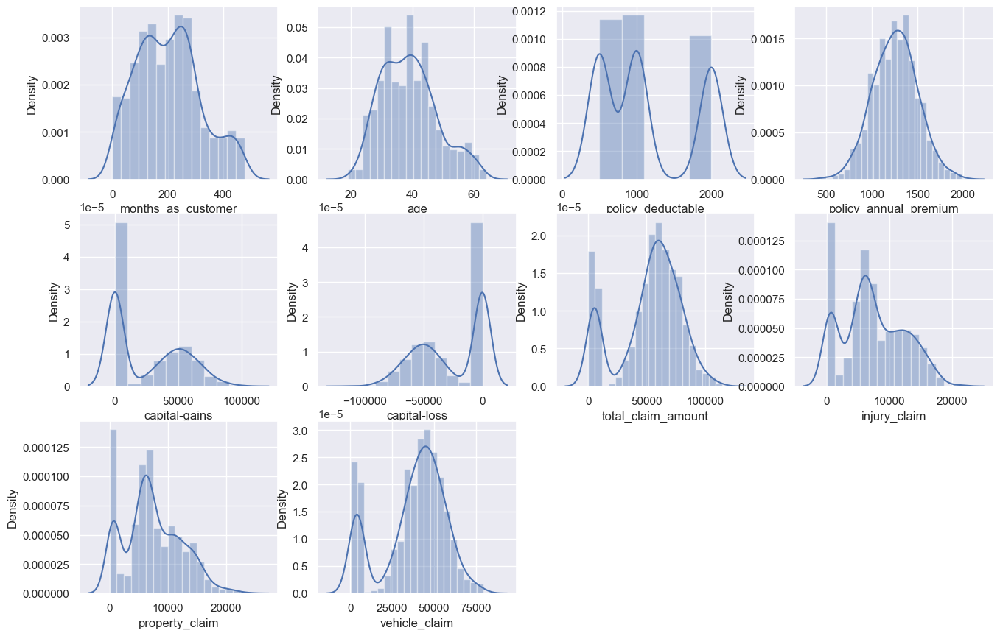

In [972]:
col=['months_as_customer','age','policy_deductable','policy_annual_premium','capital-gains','capital-loss','total_claim_amount','injury_claim','property_claim','vehicle_claim']


plt.figure(figsize=(16,14))
k=1
for i in col :
    plt.subplot(4,4,k)
    sns.distplot(df[i])
    k=k+1
plt.show()


All the above data are almost normally distributed

In [973]:
# An umbrella policy is a policy that provides excess limits and gives additional excess coverage over the normal limits and coverage of liability policies
df['umbrella_limit'].value_counts()

 0           798
 6000000      57
 5000000      46
 4000000      39
 7000000      29
 3000000      12
 8000000       8
 9000000       5
 2000000       3
 10000000      2
-1000000       1
Name: umbrella_limit, dtype: int64

In [974]:
a=df[df['umbrella_limit'] >0]

C:\Users\angsh\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='umbrella_limit', ylabel='Density'>

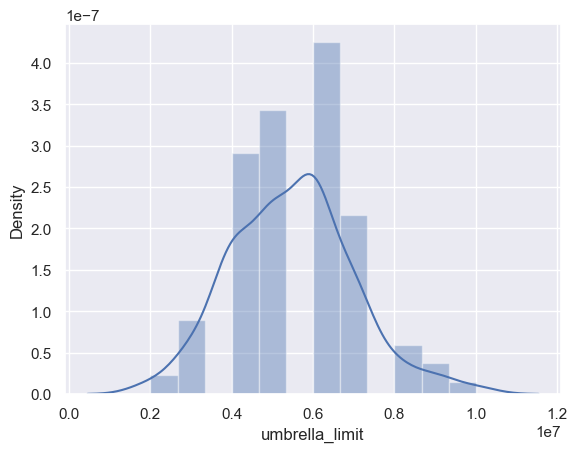

In [975]:
#To know the distribution of the umbrella limit
sns.distplot(a['umbrella_limit'])

In [976]:
df.columns

Index(['months_as_customer', 'age', 'policy_number', 'policy_bind_date',
       'policy_state', 'policy_csl', 'policy_deductable',
       'policy_annual_premium', 'umbrella_limit', 'insured_zip', 'insured_sex',
       'insured_education_level', 'insured_occupation', 'insured_hobbies',
       'insured_relationship', 'capital-gains', 'capital-loss',
       'incident_date', 'incident_type', 'collision_type', 'incident_severity',
       'authorities_contacted', 'incident_state', 'incident_city',
       'incident_location', 'incident_hour_of_the_day',
       'number_of_vehicles_involved', 'property_damage', 'bodily_injuries',
       'witnesses', 'police_report_available', 'total_claim_amount',
       'injury_claim', 'property_claim', 'vehicle_claim', 'auto_make',
       'auto_model', 'auto_year', 'fraud_reported'],
      dtype='object')

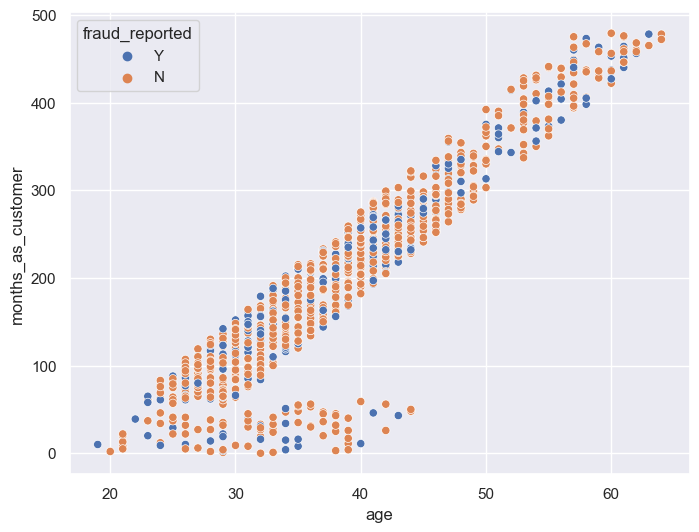

In [977]:
plt.figure(figsize=(8,6))
sns.scatterplot(x='age', y='months_as_customer',hue='fraud_reported',data=df)
plt.grid(True)
plt.show()

We do not have any pattern which justifies if customers with more years with the company are claiming fraud insurance.

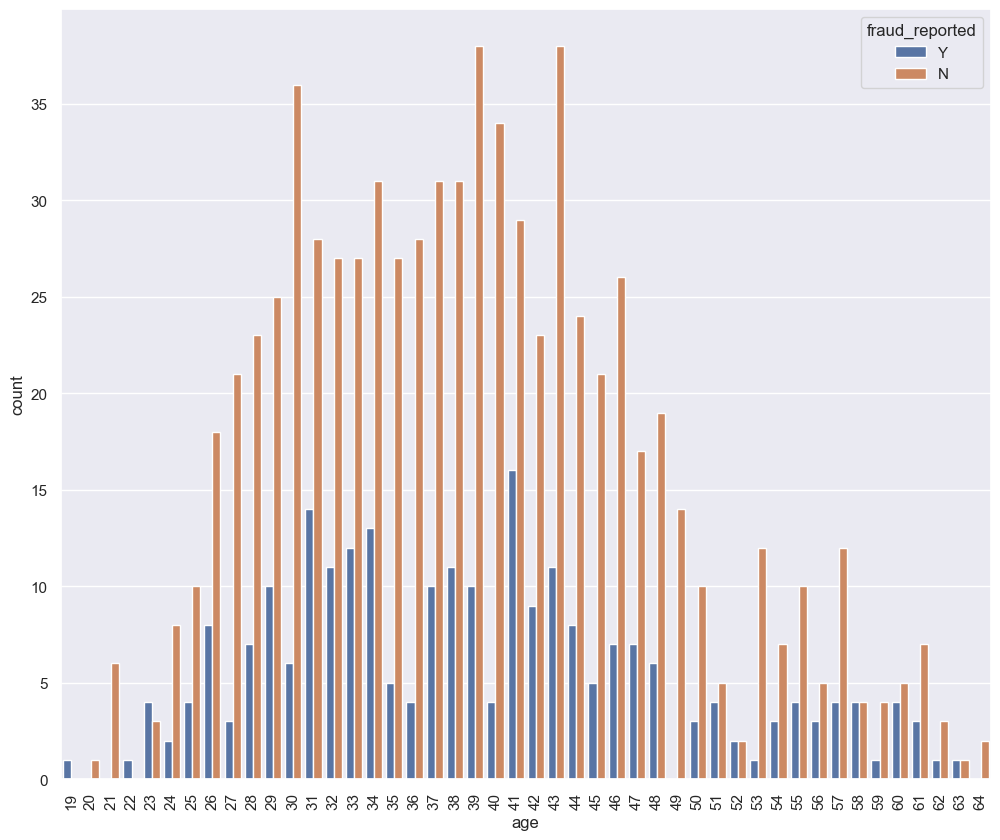

In [978]:
plt.figure(figsize=(12,10))
sns.countplot(x='age',hue='fraud_reported',data=df)
plt.xticks(rotation=90)
plt.show()

In [979]:
# Taking a as a new dataframe where fraude reported is yes in the dataset.
a=df[df['fraud_reported'] == 'Y']

a[['policy_number','insured_occupation','insured_education_level','total_claim_amount']].sort_values('total_claim_amount',ascending=False)[:20]

,policy_number,insured_occupation,insured_education_level,total_claim_amount
149,217938,craft-repair,JD,112320
163,346940,prof-specialty,Masters,107900
479,753844,sales,MD,104610
145,515050,exec-managerial,Associate,99320
247,187775,other-service,JD,98670
91,127754,tech-support,Associate,98340
974,291006,transport-moving,JD,98280
23,115399,priv-house-serv,MD,98160
41,616337,transport-moving,Associate,97080
796,728025,machine-op-inspct,Masters,92730


We have top 20 fraud claims with policy number and their occupation listed
Policy number 217938 has claimed highest amount of 112320$ and is working as craft-repair

In [980]:
a['insured_education_level'].value_counts()


JD             42
MD             38
High School    36
Associate      34
PhD            33
College        32
Masters        32
Name: insured_education_level, dtype: int64

In [981]:
#People who have educxation level as JD has claimed more fraud transactions

In [982]:
a['insured_occupation'].value_counts()

exec-managerial      28
craft-repair         22
machine-op-inspct    22
tech-support         22
transport-moving     21
sales                21
prof-specialty       18
armed-forces         17
farming-fishing      16
protective-serv      14
priv-house-serv      12
other-service        12
handlers-cleaners    11
adm-clerical         11
Name: insured_occupation, dtype: int64

People who are working as exec-manager has claimed more fraud transactions

C:\Users\angsh\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
C:\Users\angsh\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


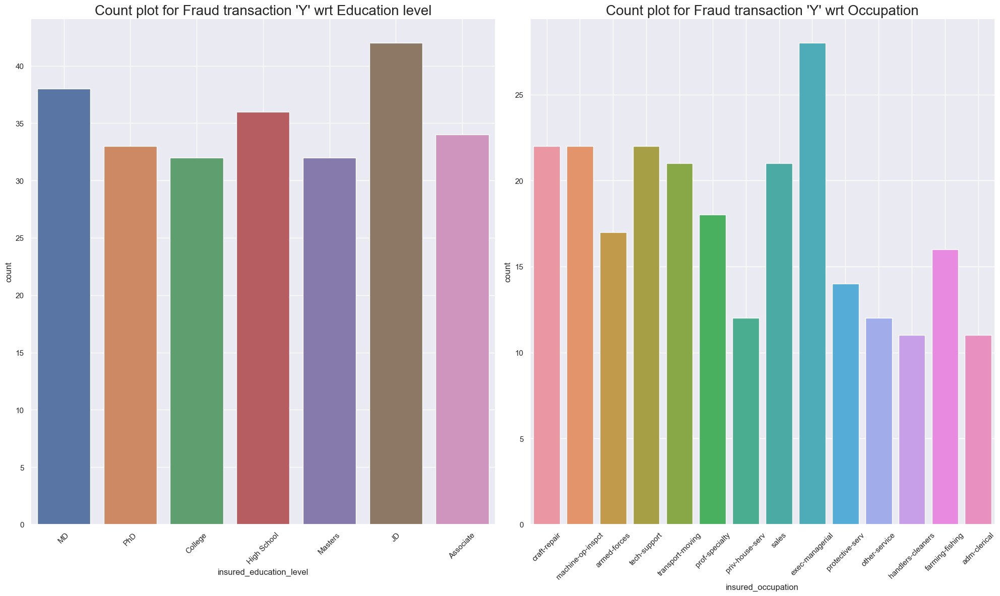

In [983]:
sns.set(style="darkgrid")

plt.figure(figsize=(20,12))
plt.subplot(1,2,1)
plt.title("Count plot for Fraud transaction 'Y' wrt Education level",fontsize=20)
sns.countplot('insured_education_level',data=a)
plt.xticks(rotation=45)
plt.grid(True)
plt.tight_layout()
plt.subplot(1,2,2)
plt.title("Count plot for Fraud transaction 'Y' wrt Occupation",fontsize=20)
sns.countplot('insured_occupation',data=a)
plt.xticks(rotation=45)
plt.grid(True)
plt.tight_layout()
plt.show()

People with occupation as Exec Manager seems to be doing more fraud transactions and people with JD level of education are also involved in more fraud transactions. Comparitively people with less education are claiming more fraud claims.

In [984]:
#Looking at below maximum clam amount as per insured occupation and education level. 
a_claims=pd.pivot_table(a,values='total_claim_amount',index=['insured_occupation','insured_education_level']).sort_values('total_claim_amount',ascending=False)

cm = sns.light_palette("blue", as_cmap=True)
a_claims.style.background_gradient(cmap=cm)

People from occupation sector Protective-services and education level of JD has highest fraud claimed amount of 87,890$

C:\Users\angsh\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


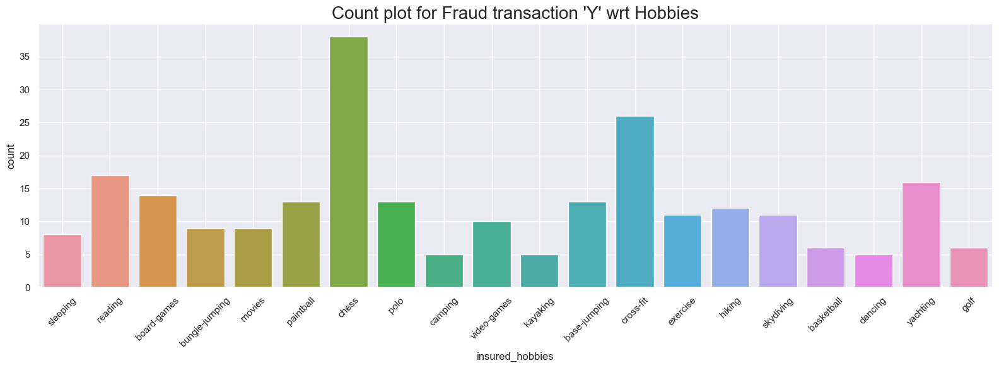

In [985]:
plt.figure(figsize=(16,6))
plt.title("Count plot for Fraud transaction 'Y' wrt Hobbies",fontsize=20)
sns.countplot('insured_hobbies',data=a)
plt.xticks(rotation=45)
plt.grid(True)
plt.tight_layout()
plt.show()

People who play more chess have claimed more fraud followed by crossfit

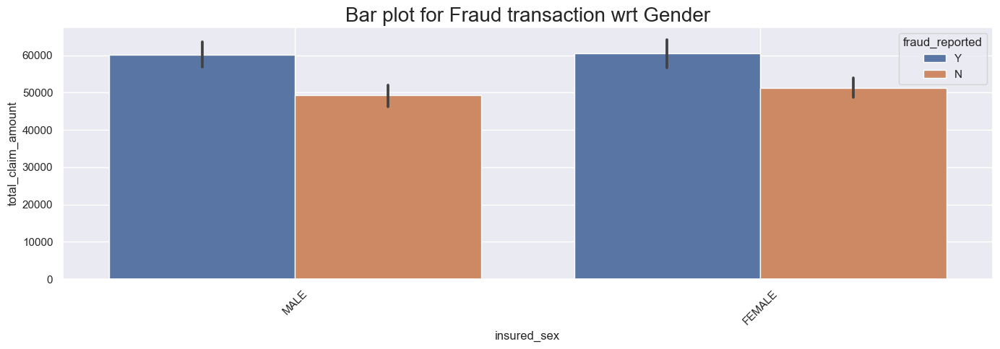

In [986]:
plt.figure(figsize=(14,5))
plt.title("Bar plot for Fraud transaction wrt Gender",fontsize=20)
sns.barplot(x='insured_sex',y='total_claim_amount',hue='fraud_reported',data=df)
plt.xticks(rotation=45)
plt.grid(True)
plt.tight_layout()
plt.show()

Both Male and female have caimed same amount which are fraud

In [987]:
a['insured_relationship'].value_counts()

other-relative    52
not-in-family     45
wife              42
own-child         39
husband           35
unmarried         34
Name: insured_relationship, dtype: int64

In [988]:
# calculating profit based on capital gains and capital loss for the insurance company
profit=df['capital-gains']-df['capital-loss']
df1=df
df1['profit']=profit

In [989]:
df1.columns

Index(['months_as_customer', 'age', 'policy_number', 'policy_bind_date',
       'policy_state', 'policy_csl', 'policy_deductable',
       'policy_annual_premium', 'umbrella_limit', 'insured_zip', 'insured_sex',
       'insured_education_level', 'insured_occupation', 'insured_hobbies',
       'insured_relationship', 'capital-gains', 'capital-loss',
       'incident_date', 'incident_type', 'collision_type', 'incident_severity',
       'authorities_contacted', 'incident_state', 'incident_city',
       'incident_location', 'incident_hour_of_the_day',
       'number_of_vehicles_involved', 'property_damage', 'bodily_injuries',
       'witnesses', 'police_report_available', 'total_claim_amount',
       'injury_claim', 'property_claim', 'vehicle_claim', 'auto_make',
       'auto_model', 'auto_year', 'fraud_reported', 'profit'],
      dtype='object')

In [990]:
df[['policy_number','profit']].sort_values('profit',ascending=False)[0:20]

,policy_number,profit
807,250833,192000
533,840806,164100
59,485372,153300
679,774303,151100
353,958785,150600
523,190588,149400
613,831053,148000
846,545506,142500
507,925128,142300
598,507545,141600


In [991]:
# The policy number 250833 gives us the highest profit or low claim.

In [992]:
df[['incident_date', 'incident_type', 'collision_type', 'incident_severity',
       'authorities_contacted', 'incident_state', 'incident_city',
       'incident_location', 'incident_hour_of_the_day',
       'number_of_vehicles_involved']]

,incident_date,incident_type,collision_type,incident_severity,authorities_contacted,incident_state,incident_city,incident_location,incident_hour_of_the_day,number_of_vehicles_involved
0,2015-01-25,Single Vehicle Collision,Side Collision,Major Damage,Police,SC,Columbus,9935 4th Drive,5,1
1,2015-01-21,Vehicle Theft,?,Minor Damage,Police,VA,Riverwood,6608 MLK Hwy,8,1
2,2015-02-22,Multi-vehicle Collision,Rear Collision,Minor Damage,Police,NY,Columbus,7121 Francis Lane,7,3
3,2015-01-10,Single Vehicle Collision,Front Collision,Major Damage,Police,OH,Arlington,6956 Maple Drive,5,1
4,2015-02-17,Vehicle Theft,?,Minor Damage,None,NY,Arlington,3041 3rd Ave,20,1
...,...,...,...,...,...,...,...,...,...,...
995,2015-02-22,Single Vehicle Collision,Front Collision,Minor Damage,Fire,NC,Northbrook,6045 Andromedia St,20,1
996,2015-01-24,Single Vehicle Collision,Rear Collision,Major Damage,Fire,SC,Northbend,3092 Texas Drive,23,1
997,2015-01-23,Multi-vehicle Collision,Side Collision,Minor Damage,Police,NC,Arlington,7629 5th St,4,3
998,2015-02-26,Single Vehicle Collision,Rear Collision,Major Damage,Other,NY,Arlington,6128 Elm Lane,2,1


In [993]:
pd.pivot_table(a,values=['number_of_vehicles_involved','total_claim_amount','vehicle_claim','incident_hour_of_the_day'],index=['incident_type','collision_type']).sort_values('vehicle_claim',ascending=False)

incident_hour_of_the_day  \
incident_type            collision_type                              
Single Vehicle Collision Front Collision                 11.595238   
                         Side Collision                  11.787879   
                         Rear Collision                  11.071429   
Multi-vehicle Collision  Side Collision                  11.432432   
                         Front Collision                 11.892857   
                         Rear Collision                  14.142857   
Parked Car               ?                                7.000000   
Vehicle Theft            ?                                5.375000   

                                          number_of_vehicles_involved  \
incident_type            collision_type                                 
Single Vehicle Collision Front Collision                     1.000000   
                         Side Collision                      1.000000   
                         Rear Collision                      1.000000   
Multi-vehicle Collision  Side Collision                      2.972973   
                         Front Collision                     2.964286   
                         Rear Collision                      3.081633   
Parked Car               ?                                   1.000000   
Vehicle Theft            ?                                   1.000000   

                                          total_claim_amount  vehicle_claim  
incident_type            collision_type                                      
Single Vehicle Collision Front Collision        66596.190476   49030.000000  
                         Side Collision         68009.696970   48481.212121  
                         Rear Collision         65782.857143   47616.666667  
Multi-vehicle Collision  Side Collision         62281.621622   45308.648649  
                         Front Collision        60970.000000   43860.000000  
                         Rear Collision         61152.448980   43474.693878  
Parked Car               ?                       5093.750000    3711.250000  
Vehicle Theft            ?                       5197.500000    3665.000000

For auto claims, single vehicle side collision have claimed highest

In [994]:
df['number_of_vehicles_involved'].nunique()

4

In [995]:
df['number_of_vehicles_involved'].value_counts()

1    581
3    358
4     31
2     30
Name: number_of_vehicles_involved, dtype: int64

In [996]:
df['incident_type'].value_counts()

Multi-vehicle Collision     419
Single Vehicle Collision    403
Vehicle Theft                94
Parked Car                   84
Name: incident_type, dtype: int64

In [997]:
df['collision_type'].value_counts()

Rear Collision     292
Side Collision     276
Front Collision    254
?                  178
Name: collision_type, dtype: int64

In [998]:
# For collision type we have few ? values, which are nan values and has to be replaced/removed
#Let us see for what kind of incident we have for value ?
coll=a[['incident_type','collision_type']]
coll

,incident_type,collision_type
0,Single Vehicle Collision,Side Collision
1,Vehicle Theft,?
3,Single Vehicle Collision,Front Collision
5,Multi-vehicle Collision,Rear Collision
14,Single Vehicle Collision,Rear Collision
...,...,...
974,Multi-vehicle Collision,Side Collision
977,Multi-vehicle Collision,Side Collision
982,Multi-vehicle Collision,Front Collision
986,Single Vehicle Collision,Rear Collision


In [999]:
res=coll.loc[coll['collision_type']=='?']
res

,incident_type,collision_type
1,Vehicle Theft,?
27,Vehicle Theft,?
196,Vehicle Theft,?
281,Vehicle Theft,?
364,Parked Car,?
365,Parked Car,?
373,Parked Car,?
437,Parked Car,?
474,Parked Car,?
478,Vehicle Theft,?


In [1000]:
res['incident_type'].value_counts()

Vehicle Theft    8
Parked Car       8
Name: incident_type, dtype: int64

8 Cars which are parked and 8 cars which are theft have claimed fraud.

In [1001]:
coll_df=df[['incident_type','collision_type']]

In [1002]:
res_df=coll_df.loc[coll_df['collision_type']=='?']

In [1003]:
res_df['incident_type'].value_counts()

Vehicle Theft    94
Parked Car       84
Name: incident_type, dtype: int64

Cars which are theft and Parked are marked as ?, we can replace them wiht either NA or No collisison

In [1004]:
# Replace it with NA as some other values could bring the biasness.
df['collision_type']=df['collision_type'].replace("?","Not Applicable")

In [1005]:
df['collision_type'].value_counts()

Rear Collision     292
Side Collision     276
Front Collision    254
Not Applicable     178
Name: collision_type, dtype: int64

In [1006]:
# Now, we are trying to see in which city the incidents are more
a['incident_city'].value_counts()

Arlington      44
Columbus       39
Springfield    38
Hillsdale      35
Northbend      34
Riverwood      30
Northbrook     27
Name: incident_city, dtype: int64

People from Arlington have more auto related incidents which are claimed to be fraud

In [1007]:
pd.pivot_table(a,values=['total_claim_amount','vehicle_claim'],index=['incident_state','incident_city']).sort_values('total_claim_amount',ascending=False)[:20]

,,total_claim_amount,vehicle_claim
incident_state,incident_city,,
SC,Riverwood,78980.000000,56553.333333
OH,Columbus,78100.000000,54670.000000
NC,Northbrook,76653.333333,55346.666667
WV,Northbrook,75205.000000,53997.500000
SC,Springfield,73116.666667,50267.500000
NY,Northbrook,69730.000000,50758.571429
NC,Springfield,69270.000000,51032.000000
NY,Springfield,67157.000000,47976.000000
OH,Northbrook,66550.000000,46585.000000


Riverwood city from SC state have claimed maximum amount of fraud for auto insurance

In [1008]:
df.columns

Index(['months_as_customer', 'age', 'policy_number', 'policy_bind_date',
       'policy_state', 'policy_csl', 'policy_deductable',
       'policy_annual_premium', 'umbrella_limit', 'insured_zip', 'insured_sex',
       'insured_education_level', 'insured_occupation', 'insured_hobbies',
       'insured_relationship', 'capital-gains', 'capital-loss',
       'incident_date', 'incident_type', 'collision_type', 'incident_severity',
       'authorities_contacted', 'incident_state', 'incident_city',
       'incident_location', 'incident_hour_of_the_day',
       'number_of_vehicles_involved', 'property_damage', 'bodily_injuries',
       'witnesses', 'police_report_available', 'total_claim_amount',
       'injury_claim', 'property_claim', 'vehicle_claim', 'auto_make',
       'auto_model', 'auto_year', 'fraud_reported', 'profit'],
      dtype='object')

In [1009]:
# Trying to see the the vehicle claim data.
a.loc[(a['property_claim'] == 0.0 )&(a['vehicle_claim'] != 0.0 )]

,months_as_customer,age,policy_number,policy_bind_date,policy_state,policy_csl,policy_deductable,policy_annual_premium,umbrella_limit,insured_zip,...,witnesses,police_report_available,total_claim_amount,injury_claim,property_claim,vehicle_claim,auto_make,auto_model,auto_year,fraud_reported
60,154,34,598554,1990-02-14,IN,100/300,500,795.23,0,609216,...,1,?,69480,15440,0,54040,Nissan,Maxima,2014,Y
155,375,50,120485,2007-02-18,OH,100/300,1000,1275.39,0,466283,...,3,NO,37280,0,0,37280,Audi,A5,1996,Y
705,274,45,589094,2003-05-27,IN,250/500,1000,1353.53,0,451467,...,0,NO,58500,11700,0,46800,Accura,MDX,1995,Y
803,123,29,379268,2012-08-05,IN,250/500,500,1209.63,0,447188,...,0,YES,73260,16280,0,56980,Volkswagen,Jetta,2014,Y
843,297,48,264221,2014-07-28,IL,500/1000,1000,1243.68,0,463331,...,2,?,54960,6870,0,48090,Toyota,Corolla,2002,Y
938,147,31,746630,1997-02-10,IN,250/500,500,1054.92,6000000,468232,...,0,?,68240,8530,0,59710,Toyota,Corolla,2013,Y


C:\Users\angsh\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
C:\Users\angsh\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


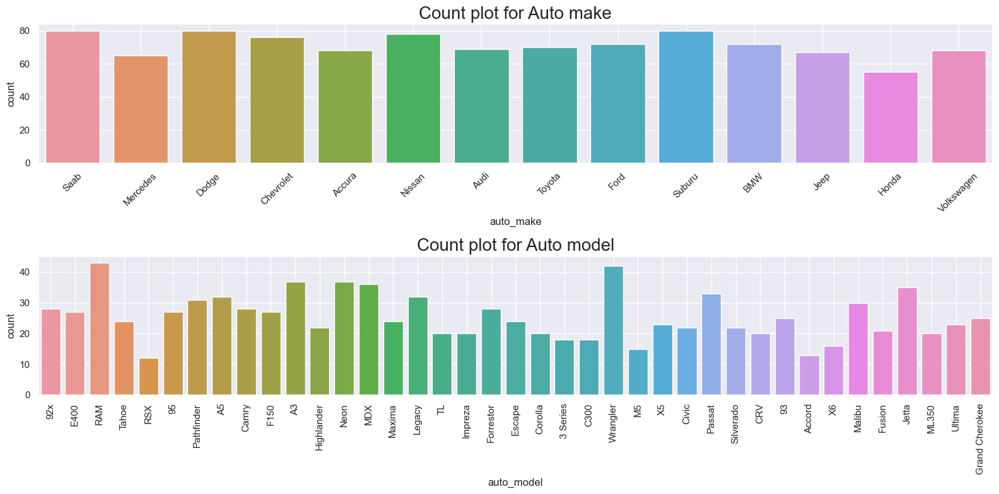

In [1010]:
plt.figure(figsize=(16,8))
plt.subplot(2,1,1)
plt.title("Count plot for Auto make",fontsize=20)
sns.countplot('auto_make',data=df)
plt.xticks(rotation=45)
plt.grid(True)
plt.tight_layout()
plt.subplot(2,1,2)
plt.title("Count plot for Auto model",fontsize=20)
sns.countplot('auto_model',data=df)
plt.xticks(rotation=90)
plt.grid(True)
plt.tight_layout()
plt.show()



In [1011]:
a['auto_make'].value_counts()

Mercedes      22
Ford          22
Chevrolet     21
Audi          21
Dodge         20
BMW           20
Suburu        19
Volkswagen    19
Saab          18
Nissan        14
Honda         14
Accura        13
Toyota        13
Jeep          11
Name: auto_make, dtype: int64

C:\Users\angsh\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


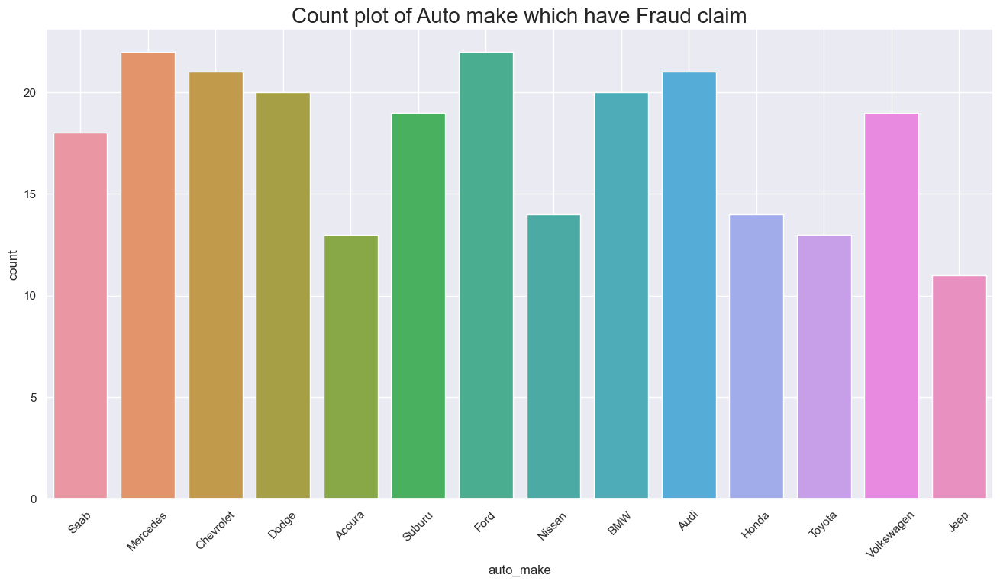

In [1012]:
plt.figure(figsize=(16,8))
plt.title("Count plot of Auto make which have Fraud claim",fontsize=20)
sns.countplot('auto_make',data=a)
plt.xticks(rotation=45)
plt.grid(True)
plt.show()

Auto make of 'Ford' and 'Mercedes' are having highest Fraud claim, 'Chevorlet' and 'Audi' also seems to be claimed equally having Fraud claims 


In [1013]:
# Vehicle claim as per auto make and model and policy number wise.
pd.pivot_table(a,values=['vehicle_claim'],index=['auto_model','auto_make','policy_number']).sort_values('vehicle_claim',ascending=False)[0:10]

,,,vehicle_claim
auto_model,auto_make,policy_number,
Impreza,Suburu,217938,77760
TL,Accura,515050,76400
Tahoe,Chevrolet,291006,75600
Neon,Dodge,346940,75530
RAM,Dodge,115399,73620
Accord,Honda,127754,71520
Highlander,Toyota,209177,69210
Tahoe,Chevrolet,187775,68310
Escape,Ford,626208,67590


Policy# 217938 who have Impreza-Suburu has claimed amount of 77,760$ and is identified as Fraud claim

<a id="4"></a>
## Data Preprocessing

In [1014]:
df.columns

Index(['months_as_customer', 'age', 'policy_number', 'policy_bind_date',
       'policy_state', 'policy_csl', 'policy_deductable',
       'policy_annual_premium', 'umbrella_limit', 'insured_zip', 'insured_sex',
       'insured_education_level', 'insured_occupation', 'insured_hobbies',
       'insured_relationship', 'capital-gains', 'capital-loss',
       'incident_date', 'incident_type', 'collision_type', 'incident_severity',
       'authorities_contacted', 'incident_state', 'incident_city',
       'incident_location', 'incident_hour_of_the_day',
       'number_of_vehicles_involved', 'property_damage', 'bodily_injuries',
       'witnesses', 'police_report_available', 'total_claim_amount',
       'injury_claim', 'property_claim', 'vehicle_claim', 'auto_make',
       'auto_model', 'auto_year', 'fraud_reported', 'profit'],
      dtype='object')

In [1015]:
a['bodily_injuries'].value_counts()

2    90
0    80
1    77
Name: bodily_injuries, dtype: int64

In [1016]:
a['police_report_available'].value_counts()

?      89
NO     86
YES    72
Name: police_report_available, dtype: int64

Even for the policies which have police report have done fraud claims

In [1017]:
# Here, we again found ? values in police report, which need to be replace.
df['police_report_available']=df['police_report_available'].replace("?","Unknown")

In [1018]:
df.columns

Index(['months_as_customer', 'age', 'policy_number', 'policy_bind_date',
       'policy_state', 'policy_csl', 'policy_deductable',
       'policy_annual_premium', 'umbrella_limit', 'insured_zip', 'insured_sex',
       'insured_education_level', 'insured_occupation', 'insured_hobbies',
       'insured_relationship', 'capital-gains', 'capital-loss',
       'incident_date', 'incident_type', 'collision_type', 'incident_severity',
       'authorities_contacted', 'incident_state', 'incident_city',
       'incident_location', 'incident_hour_of_the_day',
       'number_of_vehicles_involved', 'property_damage', 'bodily_injuries',
       'witnesses', 'police_report_available', 'total_claim_amount',
       'injury_claim', 'property_claim', 'vehicle_claim', 'auto_make',
       'auto_model', 'auto_year', 'fraud_reported', 'profit'],
      dtype='object')

In [1019]:
df.umbrella_limit.unique()

array([       0,  5000000,  6000000,  4000000,  3000000,  8000000,
        7000000,  9000000, 10000000, -1000000,  2000000], dtype=int64)

In [1020]:
# Umbrella limit can't be in negetive. So, we need to replace it with 0.
df['umbrella_limit']=df['umbrella_limit'].replace(-1000000,0)

In [1021]:
df2=df
df2

,months_as_customer,age,policy_number,policy_bind_date,policy_state,policy_csl,policy_deductable,policy_annual_premium,umbrella_limit,insured_zip,...,police_report_available,total_claim_amount,injury_claim,property_claim,vehicle_claim,auto_make,auto_model,auto_year,fraud_reported,profit
0,328,48,521585,2014-10-17,OH,250/500,1000,1406.91,0,466132,...,YES,71610,6510,13020,52080,Saab,92x,2004,Y,53300
1,228,42,342868,2006-06-27,IN,250/500,2000,1197.22,5000000,468176,...,Unknown,5070,780,780,3510,Mercedes,E400,2007,Y,0
2,134,29,687698,2000-09-06,OH,100/300,2000,1413.14,5000000,430632,...,NO,34650,7700,3850,23100,Dodge,RAM,2007,N,35100
3,256,41,227811,1990-05-25,IL,250/500,2000,1415.74,6000000,608117,...,NO,63400,6340,6340,50720,Chevrolet,Tahoe,2014,Y,111300
4,228,44,367455,2014-06-06,IL,500/1000,1000,1583.91,6000000,610706,...,NO,6500,1300,650,4550,Accura,RSX,2009,N,112000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,3,38,941851,1991-07-16,OH,500/1000,1000,1310.80,0,431289,...,Unknown,87200,17440,8720,61040,Honda,Accord,2006,N,0
996,285,41,186934,2014-01-05,IL,100/300,1000,1436.79,0,608177,...,Unknown,108480,18080,18080,72320,Volkswagen,Passat,2015,N,70900
997,130,34,918516,2003-02-17,OH,250/500,500,1383.49,3000000,442797,...,YES,67500,7500,7500,52500,Suburu,Impreza,1996,N,35100
998,458,62,533940,2011-11-18,IL,500/1000,2000,1356.92,5000000,441714,...,YES,46980,5220,5220,36540,Audi,A5,1998,N,0


In [1022]:
# Dropping columns as they they are not that important to find out fraud detect pattern.
df2=df2.drop(['policy_number','policy_bind_date','insured_zip','incident_date','authorities_contacted','profit','auto_make','auto_model'],axis=1)

In [1023]:
df2.columns

Index(['months_as_customer', 'age', 'policy_state', 'policy_csl',
       'policy_deductable', 'policy_annual_premium', 'umbrella_limit',
       'insured_sex', 'insured_education_level', 'insured_occupation',
       'insured_hobbies', 'insured_relationship', 'capital-gains',
       'capital-loss', 'incident_type', 'collision_type', 'incident_severity',
       'incident_state', 'incident_city', 'incident_location',
       'incident_hour_of_the_day', 'number_of_vehicles_involved',
       'property_damage', 'bodily_injuries', 'witnesses',
       'police_report_available', 'total_claim_amount', 'injury_claim',
       'property_claim', 'vehicle_claim', 'auto_year', 'fraud_reported'],
      dtype='object')

In [1024]:
df2=pd.get_dummies(df2,columns=['policy_state','policy_csl','insured_sex','insured_education_level','insured_occupation',
                                'insured_hobbies','insured_relationship','incident_type','collision_type','incident_severity','incident_state',
                                'incident_city','incident_location','property_damage','police_report_available'],drop_first=True)

In [1025]:
# First dummy variable for each category is dropped to avoid multicollinearity in regression models.

In [1026]:
df2.shape

(1000, 1089)

In [1027]:
df2.columns

Index(['months_as_customer', 'age', 'policy_deductable',
       'policy_annual_premium', 'umbrella_limit', 'capital-gains',
       'capital-loss', 'incident_hour_of_the_day',
       'number_of_vehicles_involved', 'bodily_injuries',
       ...
       'incident_location_9918 Andromedia Drive',
       'incident_location_9929 Rock Drive', 'incident_location_9935 4th Drive',
       'incident_location_9942 Tree Ave', 'incident_location_9980 Lincoln Ave',
       'incident_location_9988 Rock Ridge', 'property_damage_NO',
       'property_damage_YES', 'police_report_available_Unknown',
       'police_report_available_YES'],
      dtype='object', length=1089)

In [1028]:
df2['fraud_reported'].value_counts()

N    753
Y    247
Name: fraud_reported, dtype: int64

In [1029]:
# From here we can understand it is an imbalance dataset as the target features have imbalance data.

In [1030]:
df.isnull().sum()

months_as_customer             0
age                            0
policy_number                  0
policy_bind_date               0
policy_state                   0
policy_csl                     0
policy_deductable              0
policy_annual_premium          0
umbrella_limit                 0
insured_zip                    0
insured_sex                    0
insured_education_level        0
insured_occupation             0
insured_hobbies                0
insured_relationship           0
capital-gains                  0
capital-loss                   0
incident_date                  0
incident_type                  0
collision_type                 0
incident_severity              0
authorities_contacted          0
incident_state                 0
incident_city                  0
incident_location              0
incident_hour_of_the_day       0
number_of_vehicles_involved    0
property_damage                0
bodily_injuries                0
witnesses                      0
police_rep

In [1031]:
x=df2.drop(['fraud_reported'],axis=1)

In [1032]:
y=df2['fraud_reported']

# Up Sampling/Over sampling of Data

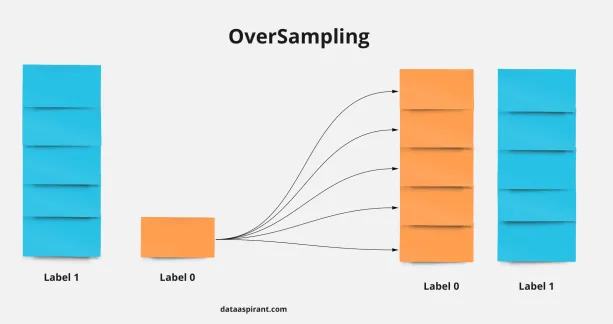

# SMOTE Oversampling

In [1033]:
!pip install imbalanced-learn

In [1034]:
from imblearn.over_sampling import SMOTE

x_upsample, y_upsample  = SMOTE().fit_resample(x, y)

print(x_upsample.shape)
print(y_upsample.shape)

(1506, 1088)
(1506,)


In [1035]:
y_upsample.value_counts()

Y    753
N    753
Name: fraud_reported, dtype: int64

In [1036]:
# By sampling technique now we made the target variable as balance dataset.

<a id="5"></a>
## Machine Learning Modelling

In [1037]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(x_upsample, y_upsample, test_size=0.2, random_state=42)

In [1038]:
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
#from sklearn.preprocessing import StandardScaler
#sc=StandardScaler()
X_train = pd.DataFrame(scaler.fit_transform(X_train),columns=list(X_train.columns))
X_test = pd.DataFrame(scaler.transform(X_test),columns=list(X_test.columns))

In [1039]:
from sklearn.linear_model import LogisticRegression

# Create an instance of the LogisticRegression model
logreg = LogisticRegression()

# Fit the model on the training data
logreg.fit(X_train, y_train)

train_accuracy = logreg.score(X_train, y_train)
print("Training Accuracy:", train_accuracy)

Training Accuracy: 0.9509966777408638


In [1040]:
from sklearn.metrics import classification_report

# Predict the labels for the training data
y_pred_train = logreg.predict(X_train)

# Generate the classification report
classification_rep_train = classification_report(y_train, y_pred_train)

# Print the classification report
print("Classification Report (Training Data):")
print(classification_rep_train)

Classification Report (Training Data):
              precision    recall  f1-score   support

           N       0.95      0.96      0.95       611
           Y       0.95      0.95      0.95       593

    accuracy                           0.95      1204
   macro avg       0.95      0.95      0.95      1204
weighted avg       0.95      0.95      0.95      1204



In [1041]:
# Predict the target variable for the testing data
y_pred = logreg.predict(X_test)

# Evaluate the model's performance
test_accuracy = logreg.score(X_test, y_test)
print("Testing Accuracy:", test_accuracy)

Testing Accuracy: 0.8543046357615894


In [1042]:
clf=classification_report(y_pred,y_test)
print("Classification Report (Testing Data):")
print(clf)

Classification Report (Testing Data):
              precision    recall  f1-score   support

           N       0.87      0.83      0.85       150
           Y       0.84      0.88      0.86       152

    accuracy                           0.85       302
   macro avg       0.86      0.85      0.85       302
weighted avg       0.86      0.85      0.85       302



In [1044]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(x_upsample, y_upsample, test_size=0.2)

In [1045]:
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
X_train = pd.DataFrame(scaler.fit_transform(X_train),columns=list(X_train.columns))
X_test = pd.DataFrame(scaler.transform(X_test),columns=list(X_test.columns))

In [1046]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV

# Create a Random Forest classifier
rf_classifier = RandomForestClassifier()

# Define the hyperparameters and their possible values
param_grid = {
    'n_estimators': [50, 100, 200],  # Number of trees in the forest
    'max_depth': [3, 3, 5],  # Maximum depth of each tree
    'min_samples_split': [2, 5, 10],  # Minimum number of samples required to split an internal node
    'min_samples_leaf': [1, 2, 4],  # Minimum number of samples required to be at a leaf node
    'max_features': ['auto', 'sqrt']  # Number of features to consider when looking for the best split
}

# Perform grid search with cross-validation
grid_search = GridSearchCV(estimator=rf_classifier, param_grid=param_grid, cv=5)
grid_search.fit(X_train, y_train)

# Get the best hyperparameters and the corresponding model
best_params = grid_search.best_params_
best_model = grid_search.best_estimator_

# Calculate the training score of the best model
training_score = best_model.score(X_train, y_train)

# Print the best hyperparameters and the training score
print("Best Hyperparameters:", best_params)
print("Training Score:", training_score)

Best Hyperparameters: {'max_depth': 5, 'max_features': 'sqrt', 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 100}
Training Score: 0.9086378737541528


In [1049]:
from sklearn.metrics import classification_report

# Predict the labels for the training data
y_pred_train = grid_search.predict(X_train)

# Generate the classification report
classification_rep = classification_report(y_train, y_pred_train)

# Print the classification report
print("Classification Report(Training Data):")
print(classification_rep)

Classification Report(Training Data):
              precision    recall  f1-score   support

           N       0.90      0.92      0.91       602
           Y       0.92      0.90      0.91       602

    accuracy                           0.91      1204
   macro avg       0.91      0.91      0.91      1204
weighted avg       0.91      0.91      0.91      1204



In [1051]:
# Calculate the test score
test_score = grid_search.score(X_test, y_test)

# Print the test score
print("Test Score:", test_score)

Test Score: 0.8145695364238411


In [1052]:
from sklearn.metrics import classification_report

# Predict the labels for the test data
y_pred_test = grid_search.predict(X_test)

# Generate the classification report
classification_rep_test = classification_report(y_test, y_pred_test)

# Print the classification report
print("Classification Report (Test Data):")
print(classification_rep_test)

Classification Report (Test Data):
              precision    recall  f1-score   support

           N       0.78      0.88      0.83       151
           Y       0.86      0.75      0.80       151

    accuracy                           0.81       302
   macro avg       0.82      0.81      0.81       302
weighted avg       0.82      0.81      0.81       302



<a id="6"></a>
## Conclusion

In [517]:
# So, By comparing those above two models, it is found that at first Logistic regression is performing better than the Random forest model.
# But after doing the hyperparameter tuning with n_estimators, max_depth, min_samples_split, min_samples_leaf and max_features and 
# With Grid search technique to search for the best combination of hyperparameters for a machine learning model, 
# The training score is nearly at 91 percent and Test score is at 83 percent which signifies a good model to predict the insurance fraud based on various factors.